In [1]:
import mne
import os
import warnings
warnings.filterwarnings('ignore')
from os.path import abspath
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mne.time_frequency import psd_welch
from tqdm import tqdm
import itertools
from multiprocessing import Process
file_path="/media/kashraf/Elements/Dissertation/data/CVPIA_eeg/Data/Cnt_files/visual/"
filename=os.listdir(file_path)
path_montage="/media/kashraf/Elements/data_gen_may_2021/montage/"
montage=mne.channels.read_montage(path_montage+"//"+"neuroscan64ch.loc")
raw_data=[]
for file in tqdm(filename):
    files=mne.io.read_raw_cnt(file_path+"/"+file,montage=montage, preload=True,verbose=False);
    raw_data.append(files)

## Selecting channels to include
good_ch= mne.pick_channels(raw_data[0].info['ch_names'], include=[],
                        exclude=["EKG","EMG",'VEO','HEO','Trigger'])
mne.pick_info(raw_data[0].info,sel=good_ch,copy=False,verbose=False)
for f in tqdm(raw_data):
    mne.pick_info(f.info,sel=good_ch,copy=False)
    f.set_montage(montage)

100%|██████████████████████████████████████████| 15/15 [00:00<00:00, 523.72it/s]


In [2]:
events= mne.events_from_annotations(raw_data[6])

# event_id_recall={'12': 1, '14': 2, '16': 3, '18': 4}
# event_id_encoding={"22":5,"24":6,"26":7,"28":8}
# # event_id_answer={""}
# event_id_answer={"51":9,"52":10}
index=[ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 13, 14]
# raw_data[[0,1]]
raw_data=[ raw_data[i] for i in index]

Used Annotations descriptions: ['12', '14', '16', '18', '2', '255', '4', '51', '52', '6', '8']


In [27]:
import multiprocessing
from tqdm import tqdm
data=dict()
for i in tqdm(range(len(raw_data))):
    data[i+1]={
    2:mne.Epochs(raw_data[i], events[0], event_id=5).get_data(),
    4:mne.Epochs(raw_data[i], events[0],event_id=7).get_data(),
    6:mne.Epochs(raw_data[i], events[0], event_id=10).get_data(),
    8:mne.Epochs(raw_data[i], events[0], event_id=11).get_data(),
    }

  0%|                                                    | 0/13 [00:00<?, ?it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


  8%|███▍                                        | 1/13 [00:00<00:01,  6.69it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 15%|██████▊                                     | 2/13 [00:00<00:01,  6.76it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 23%|██████████▏                                 | 3/13 [00:00<00:01,  6.76it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 31%|█████████████▌                              | 4/13 [00:00<00:01,  6.86it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 38%|████████████████▉                           | 5/13 [00:00<00:01,  7.05it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 46%|████████████████████▎                       | 6/13 [00:00<00:00,  7.16it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 54%|███████████████████████▋                    | 7/13 [00:00<00:00,  7.17it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 62%|███████████████████████████                 | 8/13 [00:01<00:00,  7.27it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 69%|██████████████████████████████▍             | 9/13 [00:01<00:00,  7.33it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
1 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
2 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
1 bad epochs dropped


 77%|█████████████████████████████████          | 10/13 [00:01<00:00,  7.35it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 85%|████████████████████████████████████▍      | 11/13 [00:01<00:00,  7.23it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


 92%|███████████████████████████████████████▋   | 12/13 [00:01<00:00,  7.11it/s]

60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped
60 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 60 events and 176 original time points ...
0 bad epochs dropped


100%|███████████████████████████████████████████| 13/13 [00:01<00:00,  7.11it/s]


In [4]:
# single_trial = np.reshape(data[1][2][0],(1,64,176))
# single_trial= mne.EpochsArray(single_trial,info=info,verbose=0)

# # Compute psd and generate topomaps
# psd,freq= mne.time_frequency.psd_multitaper(single_trial,tmin=0,
#                                     tmax=.14,fmin=13, fmax=30,verbose=0)
# # print(psd)
# mean_psd= np.average(psd,axis=2).flatten()
# fig=mne.viz.plot_topomap(mean_psd,pos=info,contours=False)

In [5]:
# single_trial.metadata

In [6]:
def psd_interval_gen(path=None,cl_level=None,t_nterval=None,band_with=None,cmap=None):
    tmin,tmax=t_nterval[0],t_nterval[1]
    fmin,fmax=band_with[0],band_with[1]
    for i in tqdm(range(13)):       #traverse each subject
#         print(data[i+1][cl_level] )
        sub_data = data[i+1][cl_level]          # Access subject data
        for j in (range(sub_data.shape[0])):  #traverse through trials
            single_trial = np.reshape(sub_data[j],(1,64,176))
            single_trial= mne.EpochsArray(single_trial,info=info,verbose=0)
            
            # Compute psd and generate topomaps
            psd,freq= mne.time_frequency.psd_multitaper(single_trial,tmin=tmin,
                                                tmax=tmax,fmin=fmin, fmax=fmax,verbose=0)
            mean_psd= np.average(psd,axis=2).flatten()
            fig=mne.viz.plot_topomap(mean_psd,pos=info,cmap=cmap,contours=False,show=False)
            
            # Save topo and load it
            fig_name="Sub_" + str(i+1) + "-CL_"+ str(cl_level)+"-Trial_" + str(j) + "-Interv_" + str(t_nterval[1]) + ".png"
            fig[0].get_figure().savefig(os.path.join(path,fig_name),bbox_inches='tight', transparent=True,
                                         pad_inches=0)
            plt.show("off")

In [7]:
info=raw_data[0].info
# path2="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/theta/sepate_intervals/cl2/interv5/"
# path4="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/theta/sepate_intervals/cl4/interv5/"
# path6="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/theta/sepate_intervals/cl6/interv5/"
# path8="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/theta/sepate_intervals/cl8/interv5/"

# psd_interval_gen(path2,cl_level=2,t_nterval=(0.56,0.75),band_with=(4,7),cmap="Reds")
# psd_interval_gen(path4,cl_level=4,t_nterval=(0.56,0.75),band_with=(4,7),cmap="Reds")
# psd_interval_gen(path6,cl_level=6,t_nterval=(0.56,0.75),band_with=(4,7),cmap="Reds")
# psd_interval_gen(path8,cl_level=8,t_nterval=(0.56,0.75),band_with=(4,7),cmap="Reds")

In [8]:
def img_to_array(path,dest_path,cl_level):
    for sub in tqdm(range (1,14)):
        for trial in range(60):
            tr_fname1= "Sub_" + str(sub) + "-CL_"+ str(cl_level)+"-Trial_" + str(trial) + "-Interv_" + str(0.15) + ".png"
            tr_fname2= "Sub_" + str(sub) + "-CL_"+ str(cl_level)+"-Trial_" + str(trial) + "-Interv_" + str(0.31) + ".png"
            tr_fname3= "Sub_" + str(sub) + "-CL_"+ str(cl_level)+"-Trial_" + str(trial) + "-Interv_" + str(0.47) + ".png"
            tr_fname4= "Sub_" + str(sub) + "-CL_"+ str(cl_level)+"-Trial_" + str(trial) + "-Interv_" + str(0.63) + ".png"
            tr_fname5= "Sub_" + str(sub) + "-CL_"+ str(cl_level)+"-Trial_" + str(trial) + "-Interv_" + str(0.75) + ".png"
            
            if os.path.exists(os.path.join(path,"interv1",tr_fname1)):
                im1 = cv2.imread(os.path.join(path,"interv1",tr_fname1))[...,::-1]
                im2 = cv2.imread(os.path.join(path,"interv2",tr_fname2))[...,::-1]
                im3 = cv2.imread(os.path.join(path,"interv3",tr_fname3))[...,::-1]
                im4 = cv2.imread(os.path.join(path,"interv4",tr_fname4))[...,::-1]
                im5 = cv2.imread(os.path.join(path,"interv5",tr_fname5))[...,::-1]
            else:
#                 print(os.path.join(path,"interv1",tr_fname1))
                continue
    
            np.save(os.path.join(dest_path,"cl"+str(cl_level),tr_fname1[:-16]+".npy"),
                    [im1,im2,im3,im4,im5])
    

In [9]:
import cv2
dest_path="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/alpha/all_intervals/"
path= "/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/alpha/separate_intervals/cl2"
img_to_array(path,dest_path,2)


 77%|█████████████████████████████████          | 10/13 [02:00<00:36, 12.00s/it]


KeyboardInterrupt: 

In [ ]:
from matplotlib import pyplot as plt
path3="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/alpha/cl2/interv1/Sub_1-CL_2-Trial_0-Interv_0.15.png"
path4="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/interval_topos/alpha/cl6/interv1/Sub_1-CL_6-Trial_0-Interv_0.15.png"

im1=cv2.imread(path3)[...,::-1]
np.save("okdick.npy",[im1,im1])

In [ ]:
np.load("okdick.npy").shape

In [ ]:

for i in range(len(path3)):
    if path3[i]!=path4[i]:
        print(path3[i]) 
# ==len(path4)

In [45]:
def psd_gen(sub, cl_level, fmin,fmax,cmap=None,path=None):
    sub_data= data[sub][cl_level]
#     sub_psd=[]
    for i in (range(sub_data.shape[0])):
        # Get single trial data into the right shape
        single_trial = np.reshape(sub_data[i],(1,64,176))
        single_trial= mne.EpochsArray(single_trial,info=info,verbose=0)
        
        # Get Mean psd
        psd,freq= mne.time_frequency.psd_welch(single_trial,fmin=fmin, fmax=fmax,n_fft=176,verbose=0)
        mean_psd= np.average(psd,axis=2).flatten()
#         print(mean_psd)
        fig=mne.viz.plot_topomap(mean_psd,cmap=cmap,pos=info,contours=False)
#         plt.show()
        
        new_path= os.path.join (path, "Sub_" + str(sub) + "CL_" + str(cl_level) + "Trial_" + str(i) + ".png")
        fig[0].get_figure().savefig(new_path,transparent=True,cmap=cmap,pad_inches=0.1,bbox_inches="tight")
#         plt.savefig("topo_test.png", )
        plt.show()


  0%|                                                    | 0/13 [00:00<?, ?it/s]

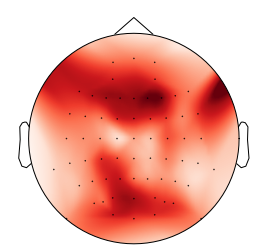

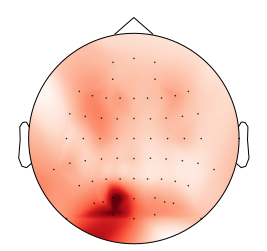

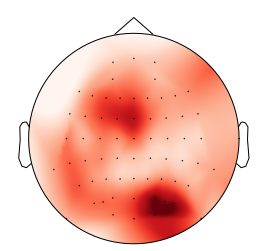

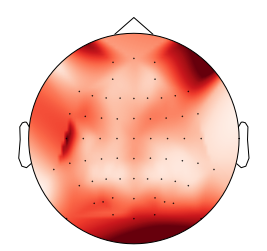

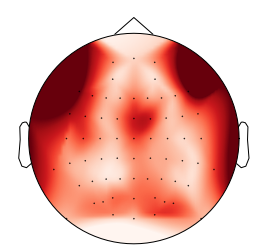

...

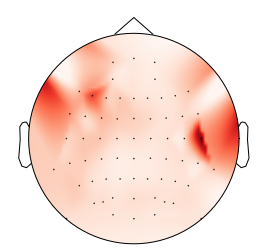

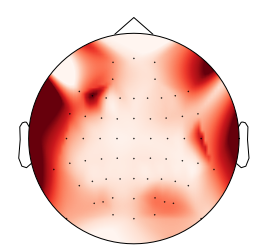

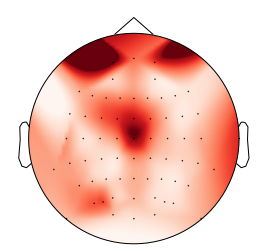

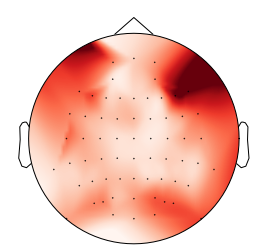

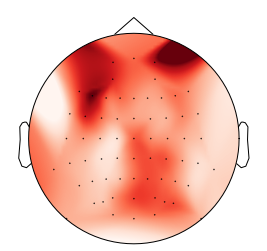

  8%|███▍                                        | 1/13 [00:06<01:14,  6.19s/it]

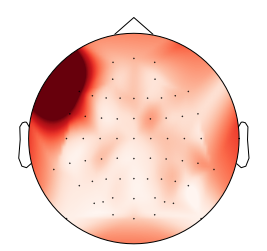

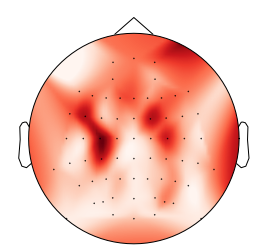

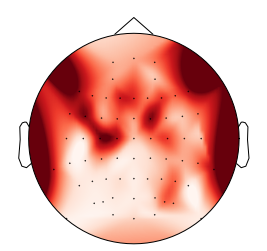

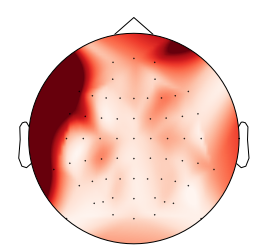

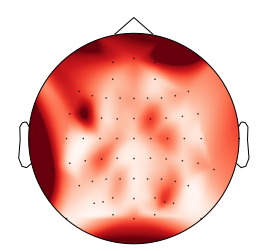

...

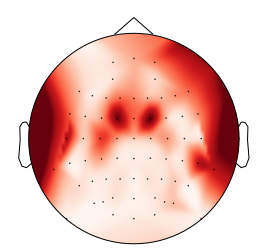

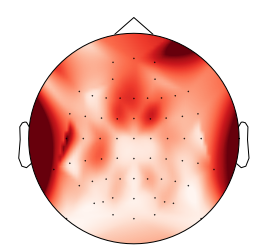

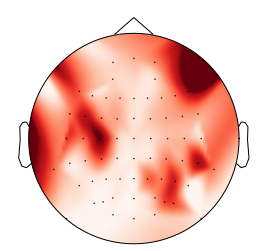

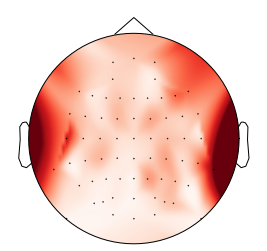

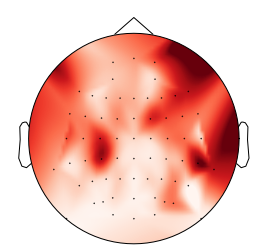

 15%|██████▊                                     | 2/13 [00:12<01:09,  6.32s/it]

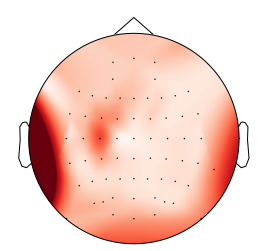

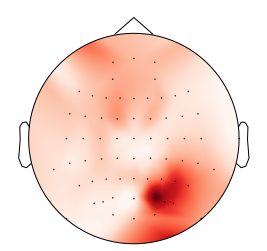

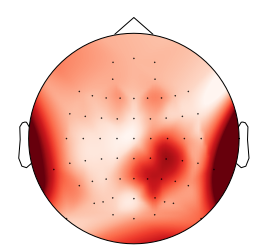

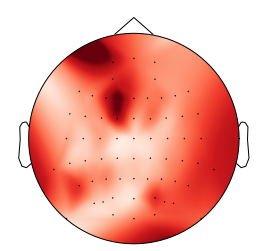

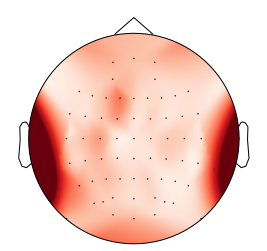

...

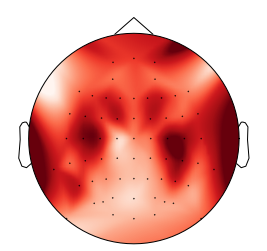

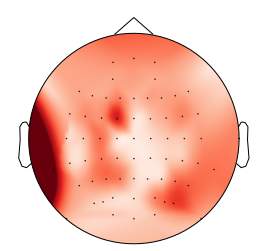

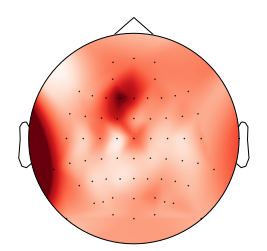

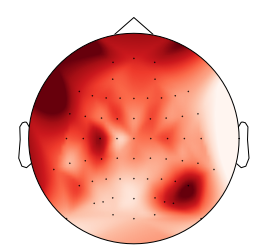

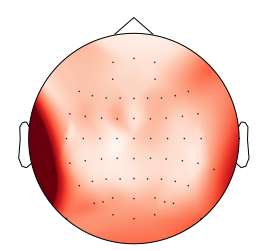

 23%|██████████▏                                 | 3/13 [00:18<01:03,  6.32s/it]

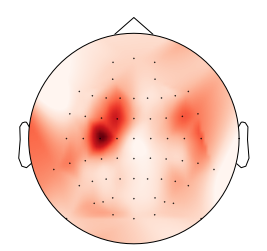

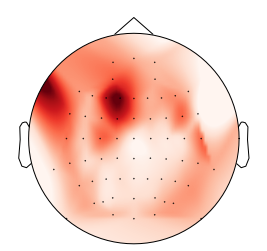

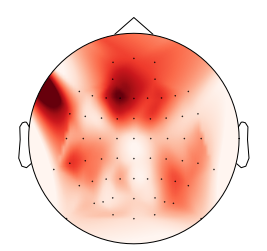

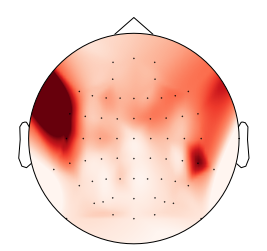

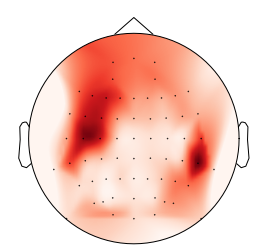

...

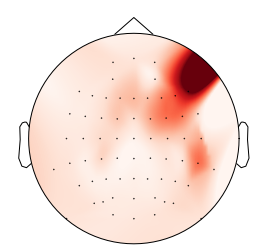

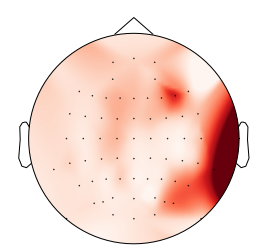

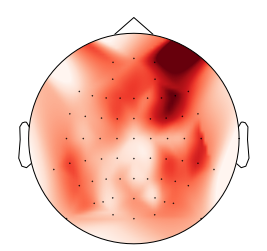

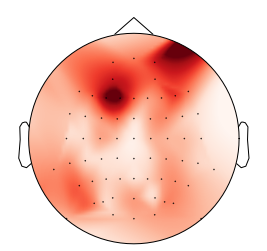

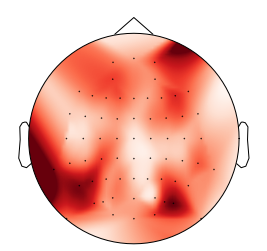

 31%|█████████████▌                              | 4/13 [00:24<00:55,  6.14s/it]

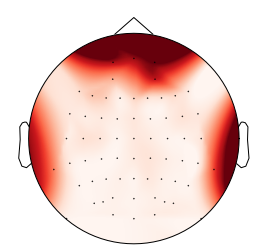

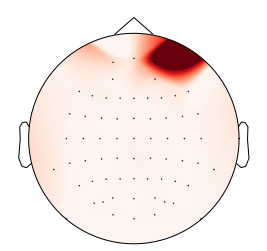

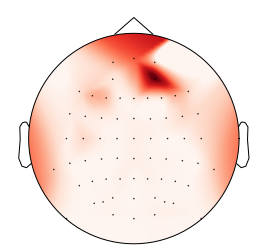

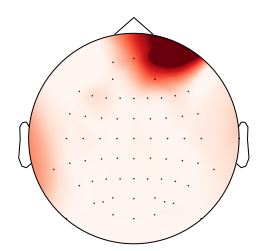

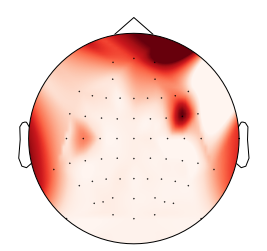

...

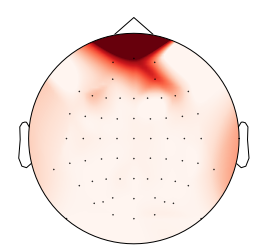

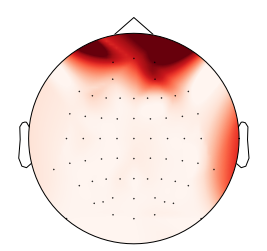

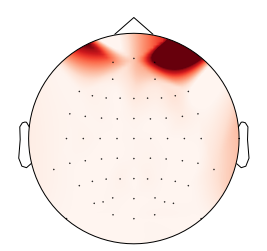

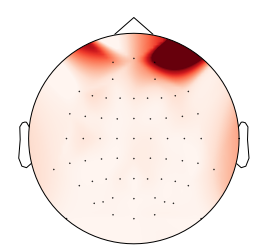

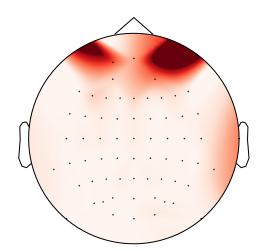

 38%|████████████████▉                           | 5/13 [00:30<00:48,  6.04s/it]

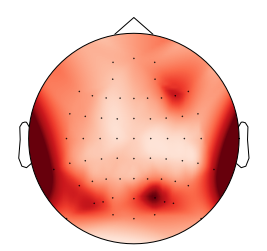

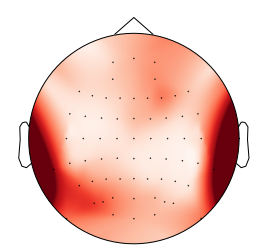

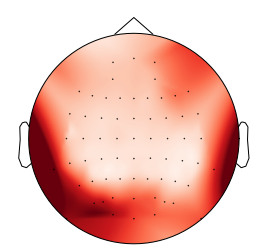

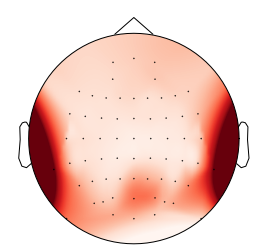

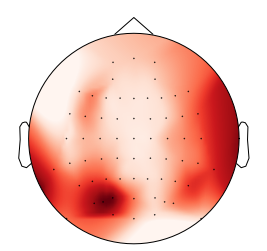

...

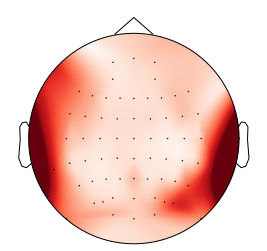

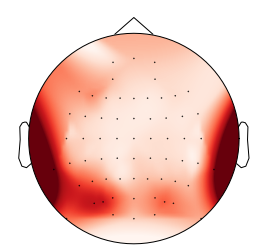

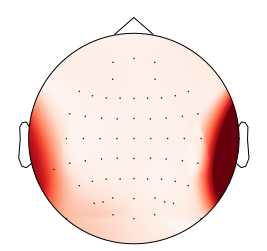

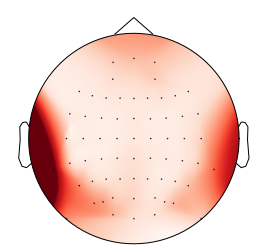

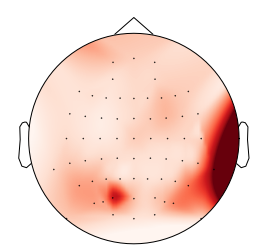

 46%|████████████████████▎                       | 6/13 [00:36<00:42,  6.00s/it]

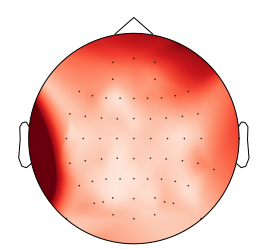

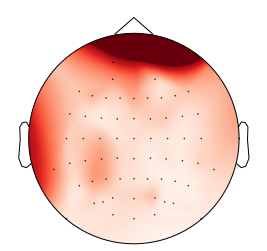

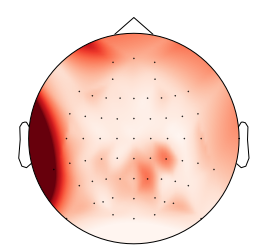

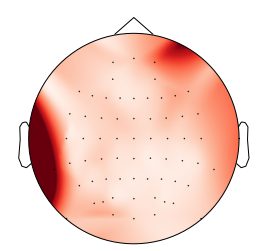

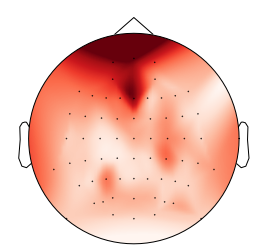

...

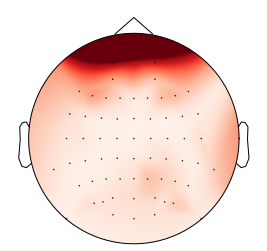

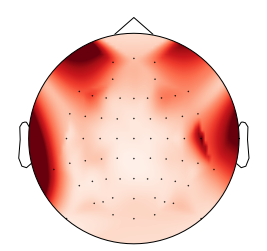

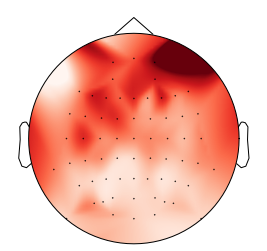

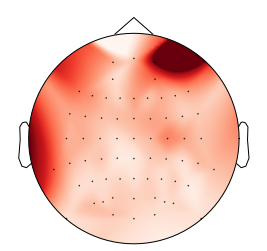

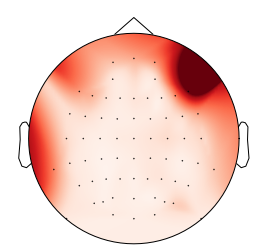

 54%|███████████████████████▋                    | 7/13 [00:42<00:35,  5.89s/it]

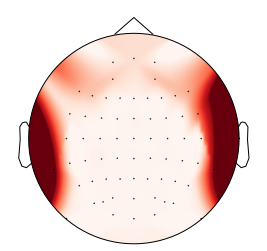

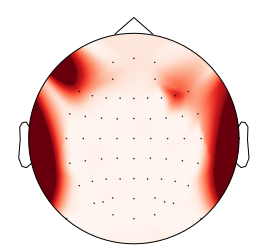

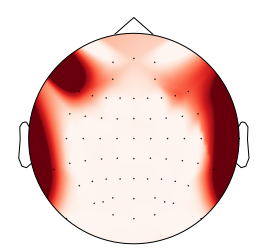

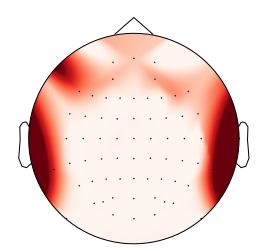

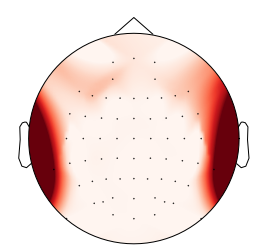

...

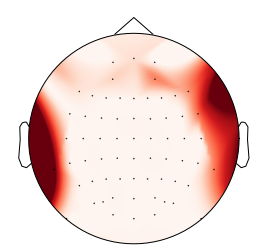

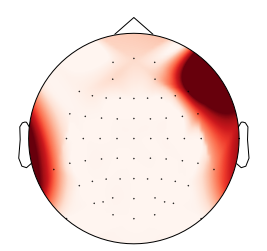

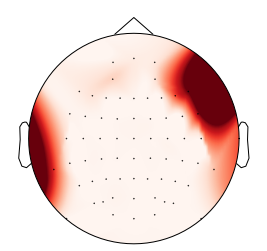

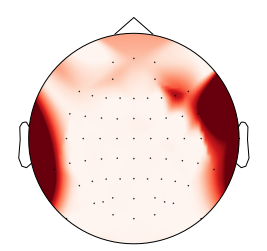

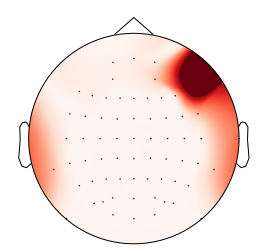

 62%|███████████████████████████                 | 8/13 [00:49<00:31,  6.32s/it]

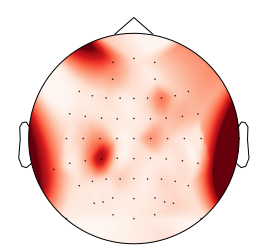

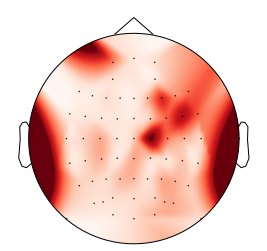

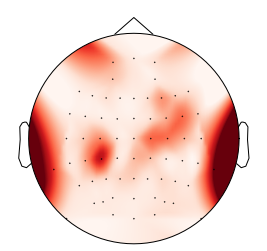

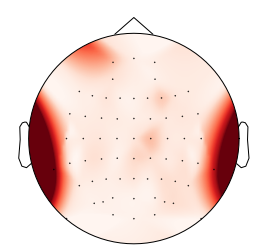

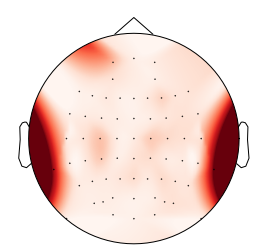

...

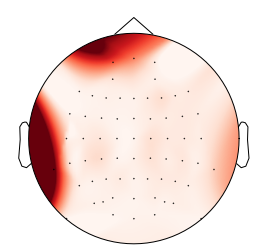

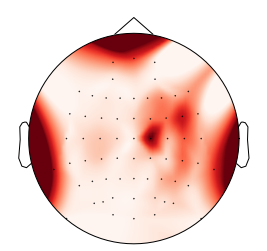

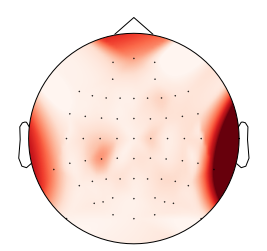

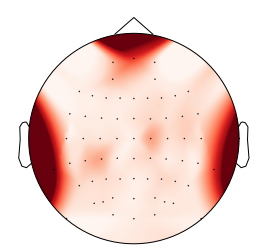

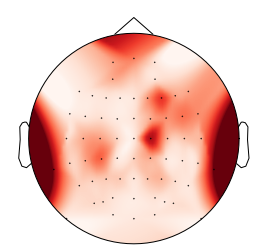

 69%|██████████████████████████████▍             | 9/13 [00:55<00:25,  6.32s/it]

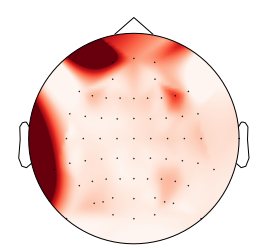

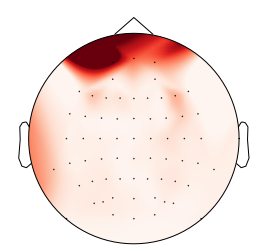

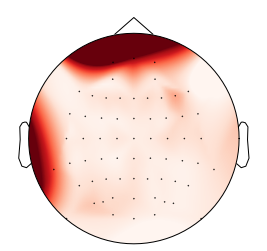

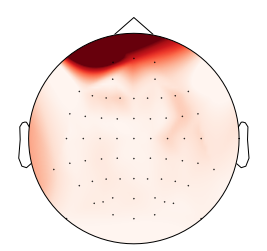

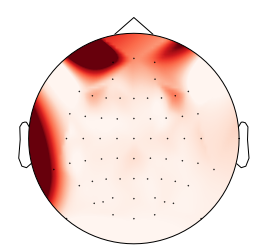

...

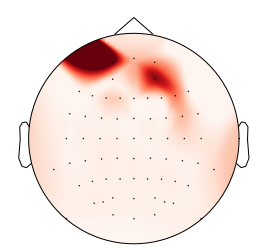

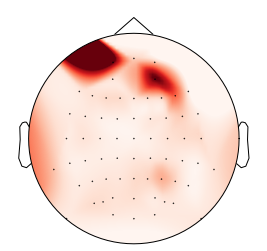

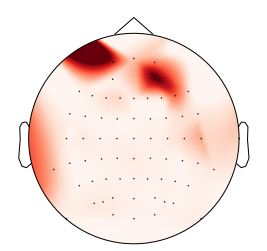

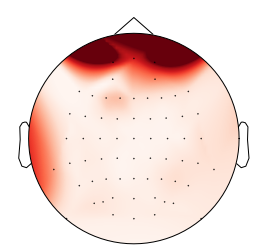

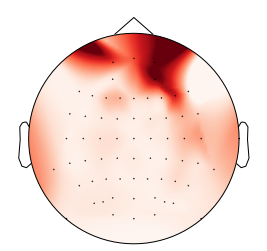

 77%|█████████████████████████████████          | 10/13 [01:01<00:18,  6.22s/it]

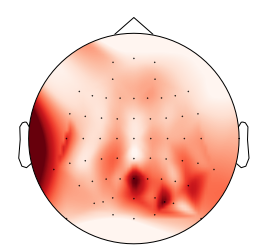

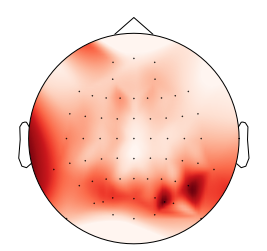

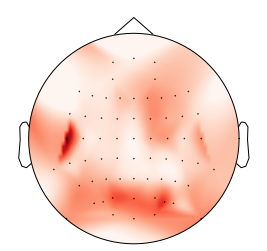

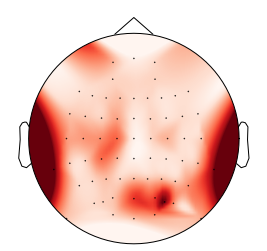

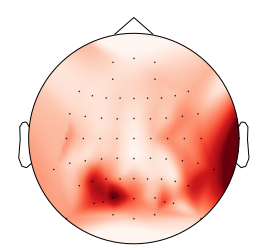

...

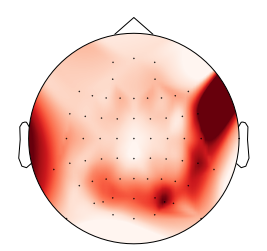

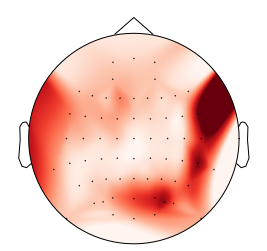

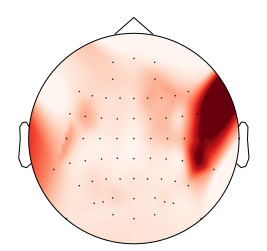

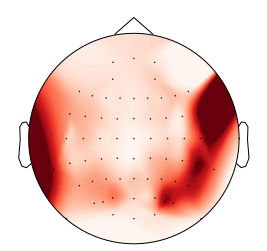

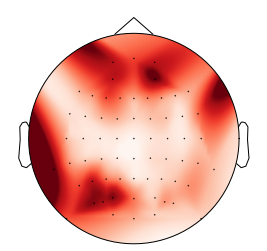

 85%|████████████████████████████████████▍      | 11/13 [01:07<00:12,  6.18s/it]

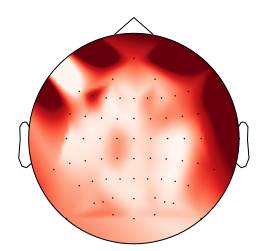

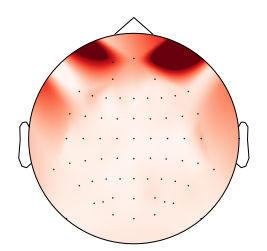

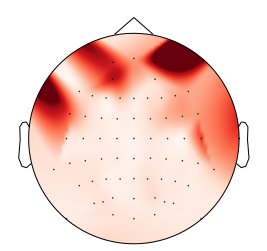

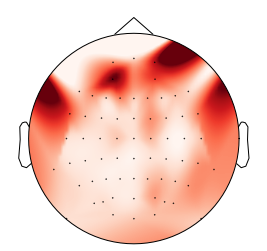

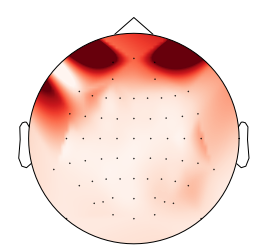

...

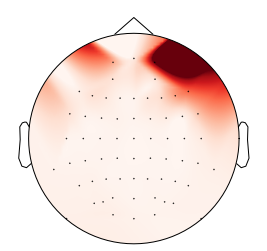

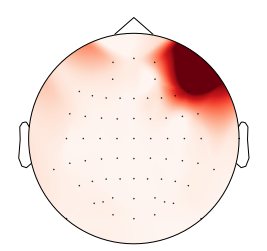

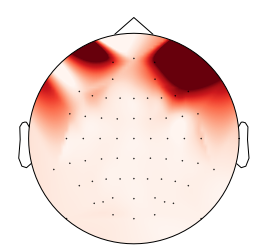

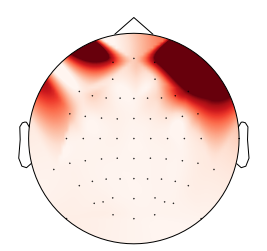

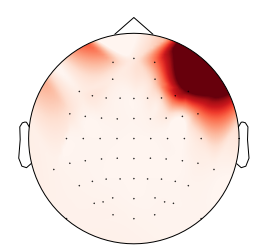

 92%|███████████████████████████████████████▋   | 12/13 [01:14<00:06,  6.17s/it]

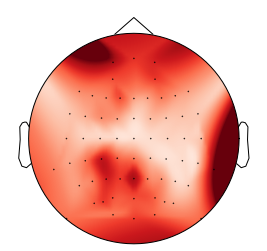

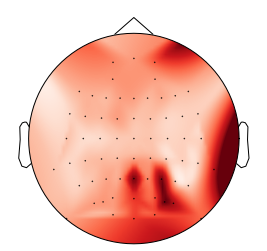

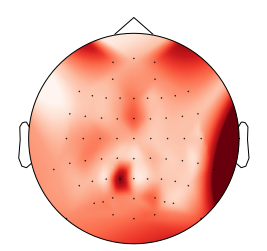

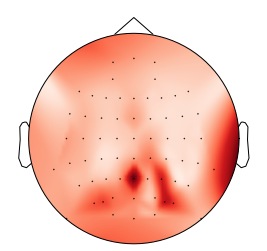

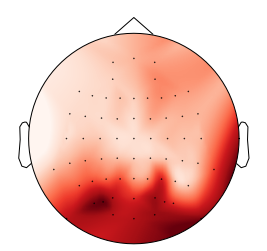

...

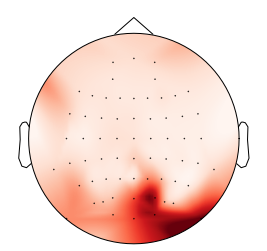

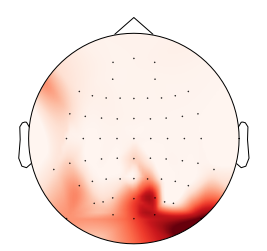

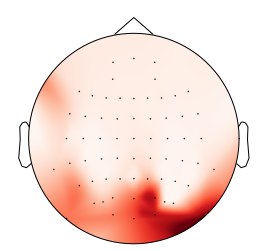

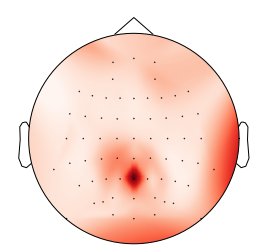

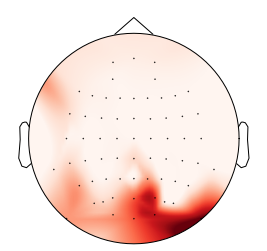

100%|███████████████████████████████████████████| 13/13 [01:20<00:00,  6.17s/it]


In [58]:
cl=8
path="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/topomaps/beta/full/cl8/"
for sub in tqdm(data):
    psd_gen(sub,cl,13,30,cmap="Reds",path=path)
plt.show("off")

In [19]:
data[1][2].shape[0]

60

In [ ]:
psds=[np.concatenate([psd_gen(data[sub],2,4,7) for sub in tqdm(data)]),
       np.concatenate([psd_gen(data[sub],4,4,7) for sub in tqdm(data)]),
       np.concatenate([psd_gen(data[sub],6,4,7) for sub in tqdm(data)]),
       np.concatenate([psd_gen(data[sub],8,4,7) for sub in tqdm(data)])]

In [ ]:
cmap=
for cl in tqdm(range(len(psds)):
    for i in range(psds[cl].shape[0]):
               psd=psds[cl][i]
               fig=mne.viz.plot_topomap( psd,info,cmap= cmap, contours=False)
    fig[0].get_figure().savefig(path+".png")  

In [ ]:
import pandas as pd
cls=[[1]*theta[0].shape[0],[2]*theta[1].shape[0],
    [3]*theta[2].shape[0],[4]*theta[3].shape[0]]
x=pd.DataFrame(np.concatenate(theta))
y=pd.DataFrame(np.concatenate(cls))
x.insert(64, "class", y, True)

###_____________________________Saving the data_______________________
path="/media/kashraf/Elements/Dissertation/data/preprocessed/visual/"
x.to_csv(os.path.join(path,"psd_data_noisy","theta_13_psd.csv"))

#### Single-Trial data generation

In [ ]:
def psd_gen(cl_level):
    psd_delta,psd_theta,psd_alpha,psd_beta, psd_gamma=[],[],[],[],[]
    for sub in data:
        for i in range(data[sub][cl_level].shape[0]):
            erp=np.reshape(data[sub][cl_level][i],(1,64,176))
            erp=mne.EpochsArray(erp,info=raw_data[0].info,verbose=0)

            ### Delta bands
            psd_d,freq= mne.time_frequency.psd_welch(erp, fmin=0, fmax=3,n_fft=176,verbose=0)
            psd_d= np.average(psd_d,axis=2).flatten()
            psd_delta.append(psd_d)
            
            ### alpha bands
            psd_t,freq= mne.time_frequency.psd_welch(erp, fmin=4, fmax=7,n_fft=176,verbose=0)
            psd_t= np.average(psd_t,axis=2).flatten()
            psd_theta.append(psd_t)
            
            ### alpha bands
            psd_a,freq= mne.time_frequency.psd_welch(erp, fmin=8, fmax=12,n_fft=176,verbose=0)
            psd_a= np.average(psd_a,axis=2).flatten()
            psd_alpha.append(psd_a)
            
            ### beta bands
            psd_b,freq= mne.time_frequency.psd_welch(erp, fmin=13, fmax=30,n_fft=176,verbose=0)
            psd_b= np.average(psd_b,axis=2).flatten()
            psd_beta.append(psd_b)
            
            ### gamma bands
            psd_g,freq= mne.time_frequency.psd_welch(erp, fmin=30,n_fft=176,verbose=0)
            psd_g= np.average(psd_g,axis=2).flatten()
            psd_gamma.append(psd_g)
            
            
    return np.array(psd_delta),np.array(psd_theta),np.array(psd_alpha),np.array(psd_beta),np.array(psd_gamma)




In [ ]:
psd_delta2,psd_theta2,psd_alpha2,psd_beta2,psd_gamma2=psd_gen(2)
psd_delta4,psd_theta4,psd_alpha4,psd_beta4,psd_gamma4=psd_gen(4)
psd_delta6,psd_theta6,psd_alpha6,psd_beta6,psd_gamma6=psd_gen(6)
psd_delta8,psd_theta8,psd_alpha8,psd_beta8,psd_gamma8=psd_gen(8)

In [ ]:
psd_delta=pd.DataFrame(np.concatenate([psd_delta2,psd_delta4,psd_delta6,psd_delta8]))
psd_theta=pd.DataFrame(np.concatenate([psd_theta2,psd_theta4,psd_theta6,psd_theta8]))
psd_alpha=pd.DataFrame(np.concatenate([psd_alpha2,psd_alpha4,psd_alpha6,psd_alpha8]))
psd_beta=pd.DataFrame(np.concatenate([psd_beta2,psd_beta4,psd_beta6,psd_beta8]))
psd_gamma=pd.DataFrame(np.concatenate([psd_gamma2,psd_gamma4,psd_gamma6,psd_gamma8]))


In [ ]:
path="/home/kashraf/Research_2021/single_trial_work/data/"

psd_alpha.to_csv(path+"alpha_single_trial.csv")
psd_delta.to_csv(path+"delta_single_trial.csv")
psd_theta.to_csv(path+"theta_single_trial.csv")
psd_beta.to_csv(path+"beta_single_trial.csv")
psd_gamma.to_csv(path+"gamma_single_trial.csv")

### Generate bootstrap sampling ERPS
- Specify number of trials for boot to calculate one erp
- Total number or erps per subject per CL level ( number of iterations for erp calculation

In [ ]:
from tqdm import tqdm

n_trials= 20# Number of trials to be selected and be averaged out to give one ERP
n_erp= 1000 # Nmber of ERPS required per subject per CL level. So for cL2 we have 1000*11 Erps
# from multiprocessing import Manager
# manager=Manager()
# data_new=manager.dict()

def bootstrap(event,trials, n_trials,n_erps):
    erps=[]
    for i in range(n_erps):
        t=np.random.choice(trials,n_trials)
        erp = np.average(event[t],axis=0)
        erps.append(erp)
    return erps
for i in tqdm(range(len(data))):
    data[i+1]["erp2"]=bootstrap(data[i+1][2], data[i+1][2].shape[0],n_trials,n_erp)
    data[i+1]["erp4"]=bootstrap(data[i+1][4], data[i+1][4].shape[0],n_trials,n_erp)
    data[i+1]["erp6"]=bootstrap(data[i+1][6], data[i+1][6].shape[0],n_trials,n_erp)
    data[i+1]["erp8"]=bootstrap(data[i+1][8], data[i+1][8].shape[0],n_trials,n_erp)

## Transform our data into epoch array
# from tqdm import tqdm
# def bootstrap_process(start):
for sub in tqdm(data):
    for i in range(1000):
        data[sub]["erp2"][i]=np.reshape(data[sub]["erp2"][i],(1,64,176))
        data[sub]["erp2"][i]=mne.EpochsArray(data[sub]["erp2"][i],info=raw_data[0].info)

        data[sub]["erp4"][i]=np.reshape(data[sub]["erp4"][i],(1,64,176))
        data[sub]["erp4"][i]=mne.EpochsArray(data[sub]["erp4"][i],info=raw_data[0].info)

        data[sub]["erp6"][i]=np.reshape(data[sub]["erp6"][i],(1,64,176))
        data[sub]["erp6"][i]=mne.EpochsArray(data[sub]["erp6"][i],info=raw_data[0].info)

        data[sub]["erp8"][i]=np.reshape(data[sub]["erp8"][i],(1,64,176))
        data[sub]["erp8"][i]=mne.EpochsArray(data[sub]["erp8"][i],info=raw_data[0].info)

### Generate and Save PSd topomaps
- Define a fx that takes a erp data and frequency band of interest and generate average PSD and their topomaps
-  Save PSD to the memory

In [ ]:
def topo_generator(my_data,band,path):
    if band=="delta":
        cmap="Greens"
        fmin=1
        fmax=3
    elif band=="delta":
        cmap="Blues"
        fmin=4
        fmax=7
    elif band=="alpha":
        cmap="Reds"
        fmin=8
        fmax=12
    elif band=="beta":
        cmap="PuRd"
        fmin=13
        fmax=30
    else:
        fmin=31
        fmax=100
        cmap="RdBu"
    psd,freq= mne.time_frequency.psd_welch(my_data, fmin= fmin, fmax=fmax,n_fft=176)
    psd1= np.average(psd,axis=2).flatten()
    fig=mne.viz.plot_topomap( psd1,my_data.info,cmap= cmap, contours=False)
    fig[0].get_figure().savefig(path+".png")  

In [ ]:
from matplotlib import cm
from multiprocessing import Manager
manager=Manager()
data_new=manager.dict()
data_new= data
path_data="/home/kashraf/felix_hd/data_gen_may_2021/topo_data_may_v1/gamma/cl8//"
# path_cl4_alpha="/home/spring2021/topomap_dataset/visual/recall/704ms/alpha/cl4//"
# path_cl8_beta=r"/home/spring2021/topomap_dataset/704ms/beta/cl8//"

def generation_process(start):
    for sub in tqdm(data_new):
        for j in tqdm(range(200)):
            my_data=data_new[sub]["erp8"][start+j]
            path=path_data+"sub_"+str(sub)+"_gamma_"+str(start+j)
            topo_generator(my_data,"gamma",path)
            


if __name__=="__main__":
    p1= Process(target=generation_process,args=(0,))
    p2= Process(target=generation_process,args=(200,))
    p3= Process(target=generation_process,args=(400,))
    p4= Process(target=generation_process,args=(600,))
    p5= Process(target=generation_process,args=(800,))
    p1.start()
    p2.start()
    p3.start()
    p4.start()
    p5.start()
   
    p1.join()
    p2.join()
    p3.join()
    p4.join()
    p5.join()
    
    print("Done")
    
    
        

In [ ]:
len(range(1,10))